<a href="https://colab.research.google.com/github/kaaliraj/myelin-foundry-challenge-style-transfer-/blob/master/myelin_foundry_challenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Here is the overview of the challenge including the project rubrics 

(https://github.com/myelin-foundry/challenge/blob/master/README.md)

In [0]:
!git clone https://github.com/myelin-foundry/challenge.git

Cloning into 'challenge'...
remote: Enumerating objects: 69, done.
remote: Counting objects: 100% (69/69), done.
remote: Compressing objects: 100% (65/65), done.
remote: Total 69 (delta 18), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (69/69), done.


In [0]:
!pwd


/content


In [0]:
cd /content/challenge

/content/challenge


This iPython notebook is an implementation of a popular paper ( [Gatys et al., 2015](https://arxiv.org/abs/1508.06576)) that demonstrates how to use neural networks to transfer artistic style from one image onto another. It is meant to go along with a [related blog post](https://harishnarayanan.org/writing/artistic-style-transfer/) that provides more context, and explains a lot of the theory behind the steps that follow.

In [0]:
from __future__ import print_function
import keras
import time
from PIL import Image 
import numpy as np
from numpy  import array
import matplotlib.pyplot as plt

from keras import backend 
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input

from scipy.optimize import fmin_l_bfgs_b
from scipy.misc import imsave

In [0]:
height = 512
width = 512

**Load and Display the content and style images**

In [0]:
content_image_path = 'japanese_garden.jpg'
content_image = Image.open(content_image_path)
content_image = content_image.resize((height, width))


In [0]:
style_image_path = 'picasso_selfportrait.jpg'
style_image = Image.open(style_image_path)
style_image = style_image.resize((height, width))


Text(0.5, 1.0, 'Style image')

<Figure size 72x72 with 0 Axes>

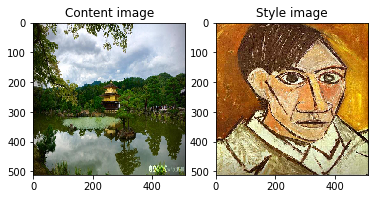

In [0]:
plt.figure(figsize=(1,1))
fig = plt.figure()
a=fig.add_subplot(121)
plt.imshow(content_image)
a.set_title('Content image')

a=fig.add_subplot(122)
plt.imshow(style_image)
a.set_title('Style image')

**Extract features of content image from intermediate layers with VGG16**

here is the reference [code](https://github.com/fchollet/deep-learning-with-python-notebooks/blob/master/5.4-visualizing-what-convnets-learn.ipynb) implemented by François Chollet

In [0]:
from keras import models
from keras.preprocessing import image as im


model_features = VGG16(weights='imagenet', include_top=False)
layer_outputs = [layer.output for layer in model_features.layers[1:]]
activation_model = models.Model(inputs=model_features.input, outputs=layer_outputs)


In [0]:
def Visualise(img_path):
  img = im.load_img(img_path, target_size=(224, 224))
  x = im.img_to_array(img)
  x = np.expand_dims(x, axis=0)
  x = preprocess_input(x)
  features = activation_model.predict(x)
  # These are the names of the layers, so can have them as part of our plot
  layer_names = []
  for layer in activation_model.layers[1:]:
      layer_names.append(layer.name)

  images_per_row = 16

    # Now let's display our feature maps
  for layer_name, layer_activation in zip(layer_names, features):
      # This is the number of features in the feature map
      n_features = layer_activation.shape[-1]

      # The feature map has shape (1, size, size, n_features)
      size = layer_activation.shape[1]

      # We will tile the activation channels in this matrix
      n_cols = n_features // images_per_row
      display_grid = np.zeros((size * n_cols, images_per_row * size))

      # We'll tile each filter into this big horizontal grid
      for col in range(n_cols):
          for row in range(images_per_row):
              channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
              # Post-process the feature to make it visually palatable
              channel_image -= channel_image.mean()
              channel_image /= channel_image.std()
              channel_image *= 64
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
              display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

      # Display the grid
      scale = 1. / size
      plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
      plt.title(layer_name)
      plt.grid(False)
      plt.imshow(display_grid, aspect='auto',cmap='viridis')
      plt.show()





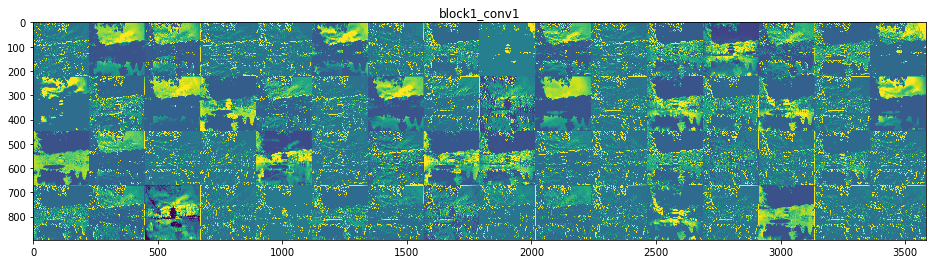

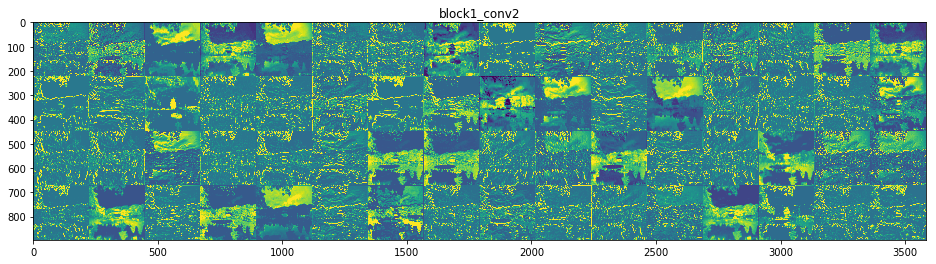

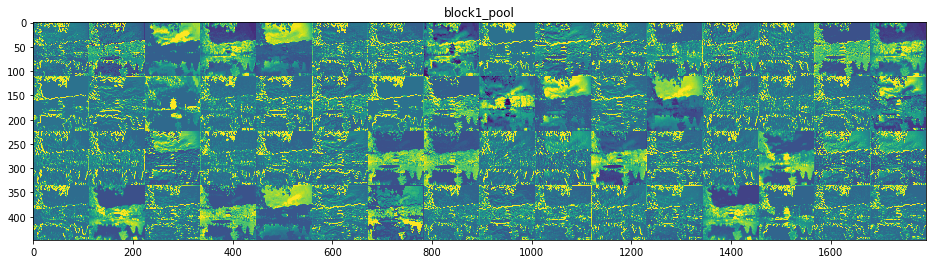

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in true_divide


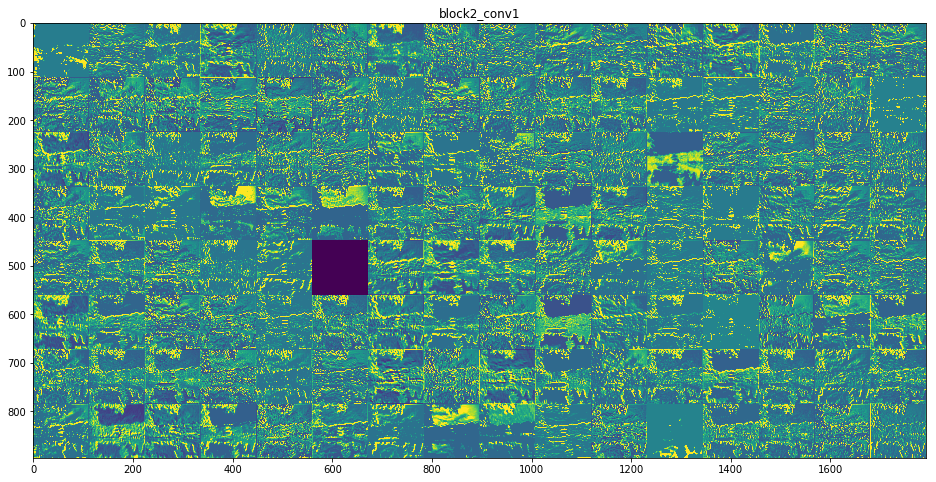

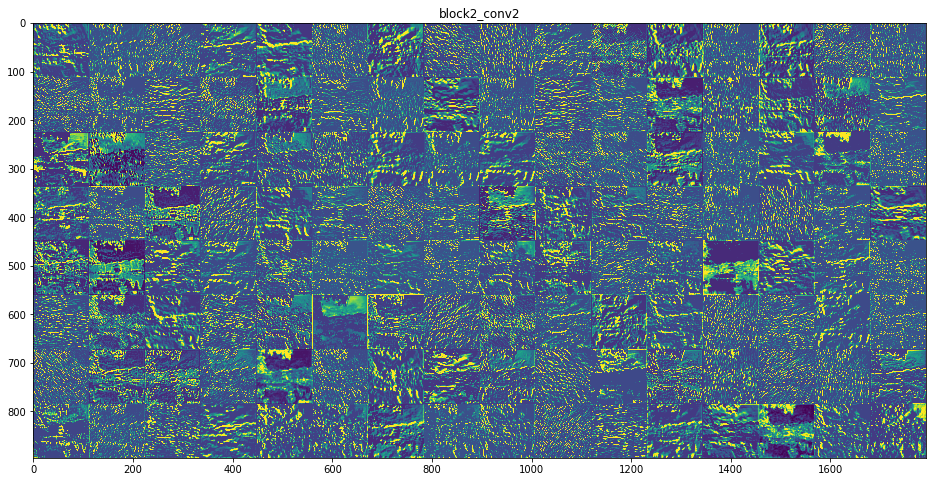

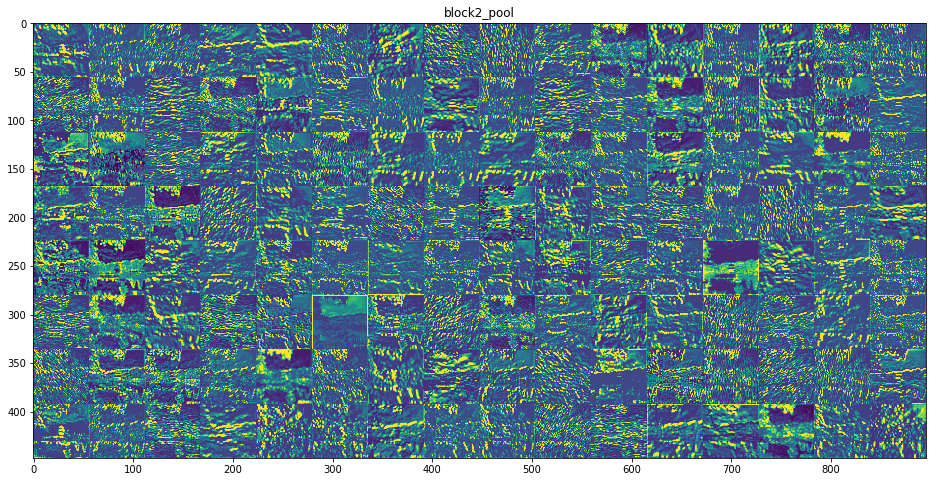

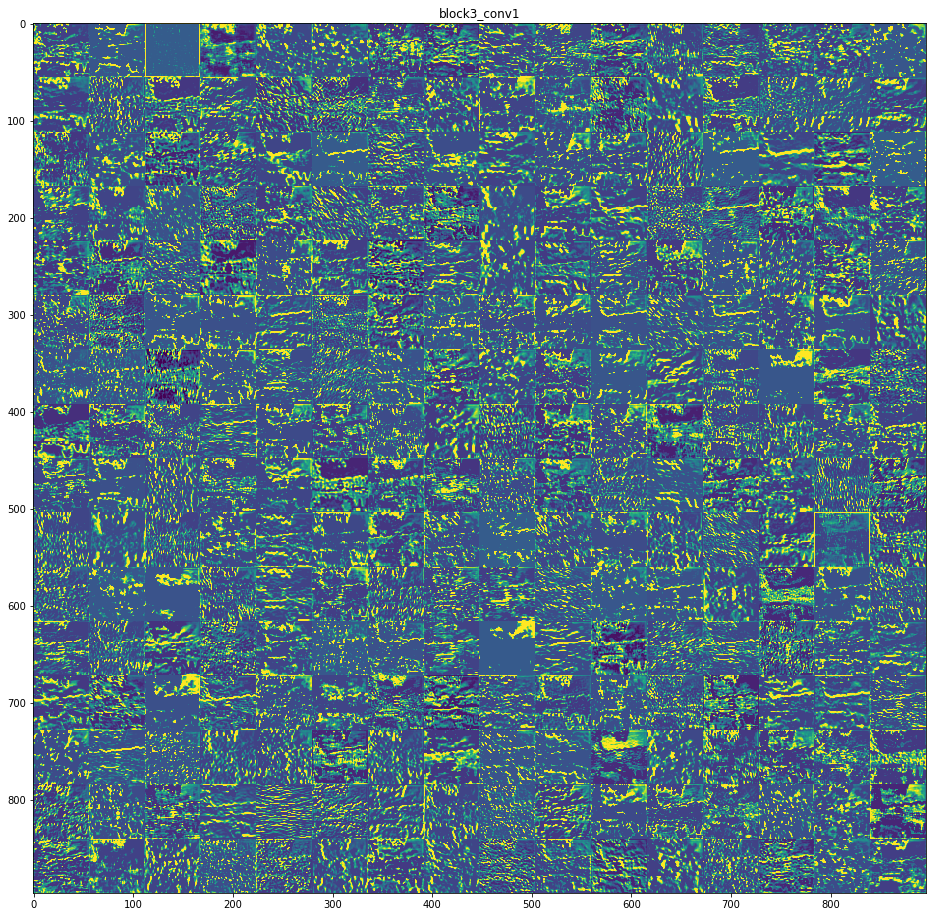

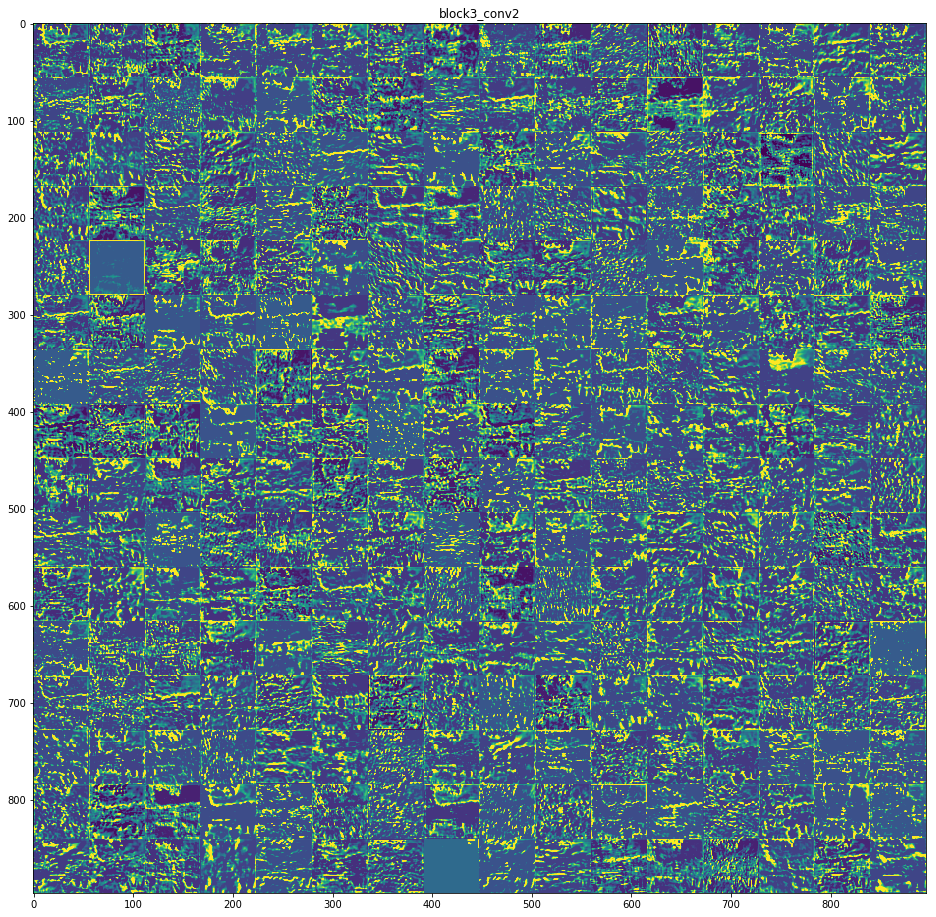

...

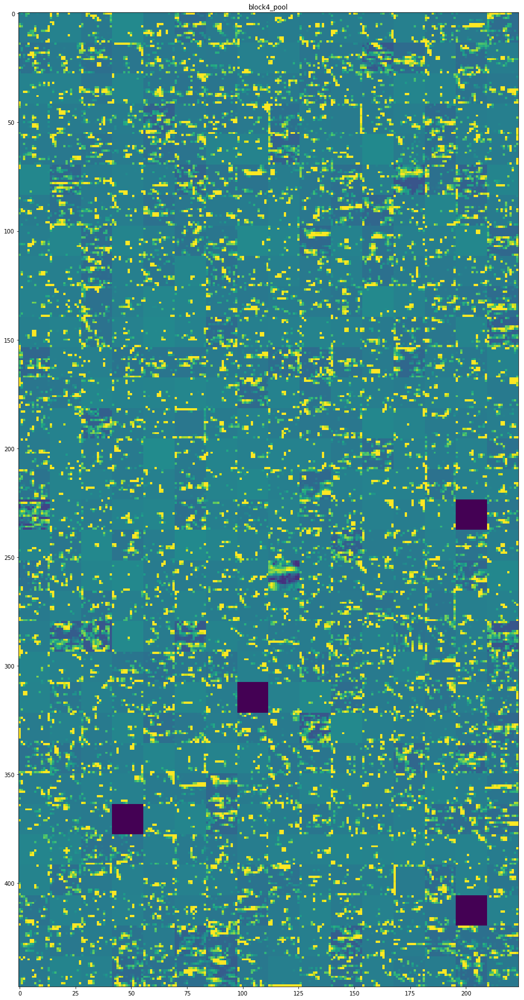

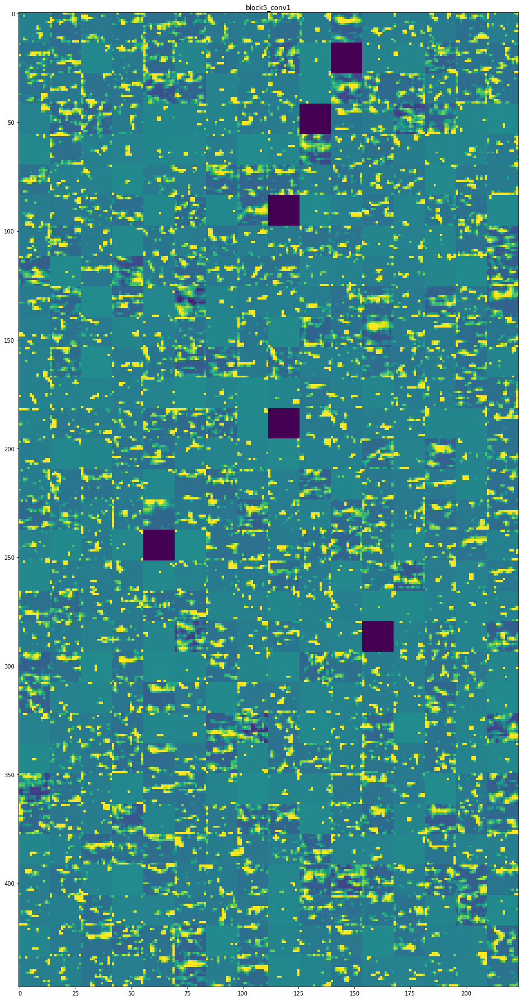

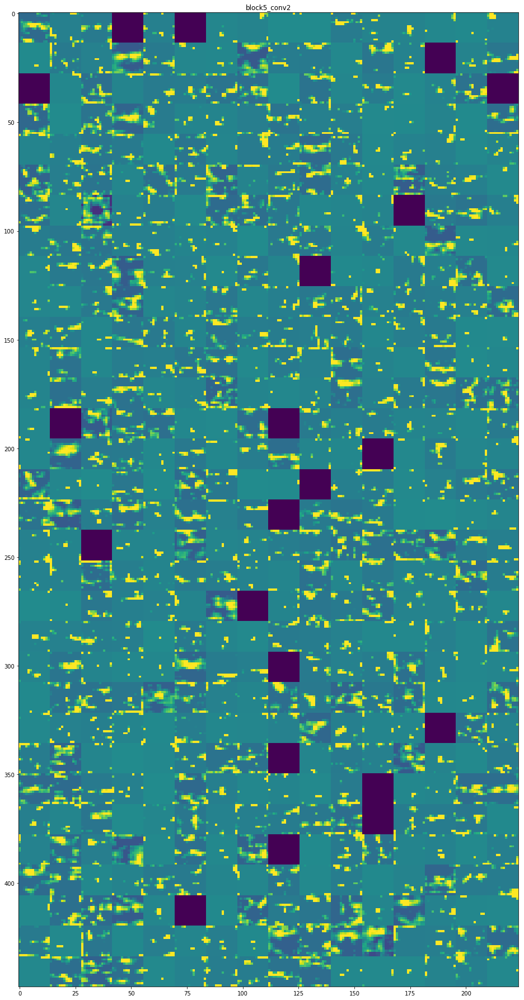

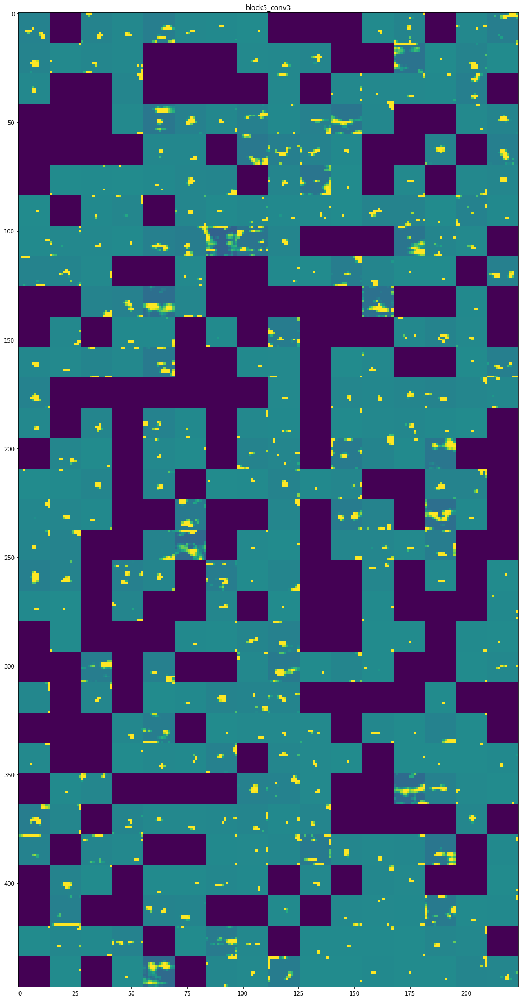

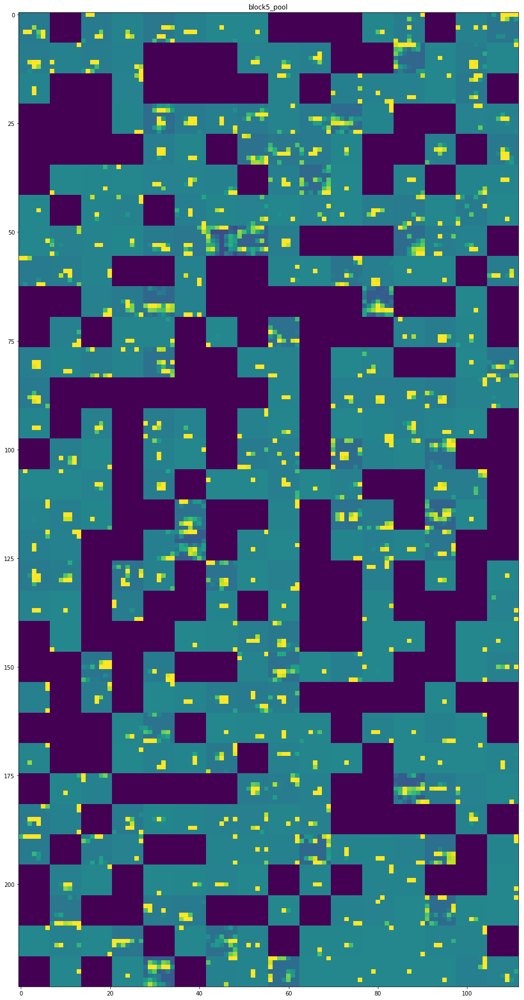

In [0]:
Visualise(img_path='japanese_garden.jpg')

**Extract features of style image from intermediate layers with VGG16**

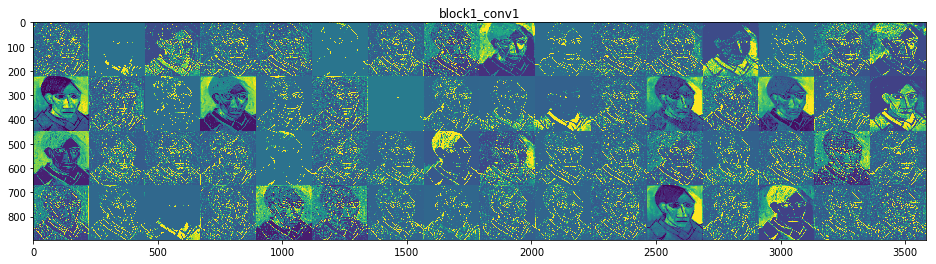

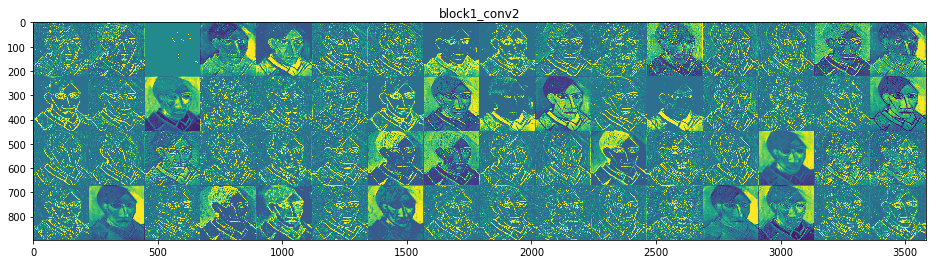

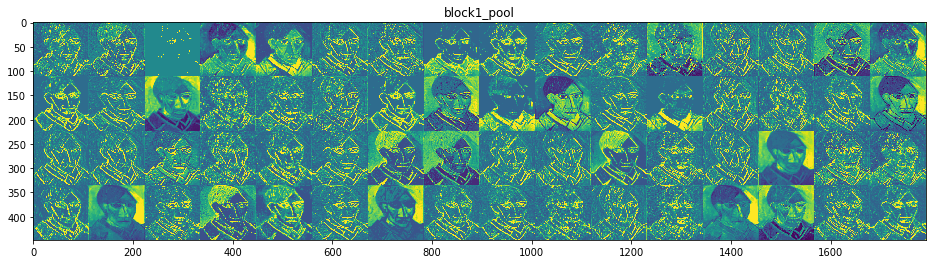

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in true_divide


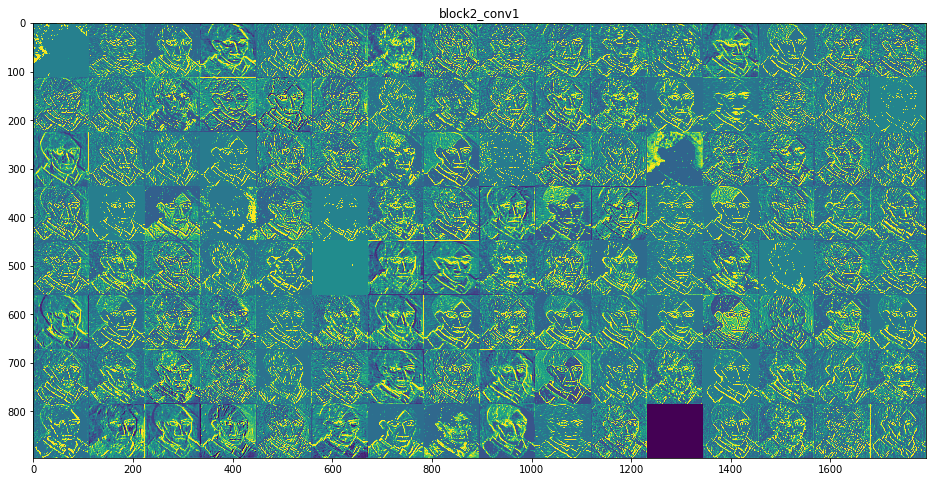

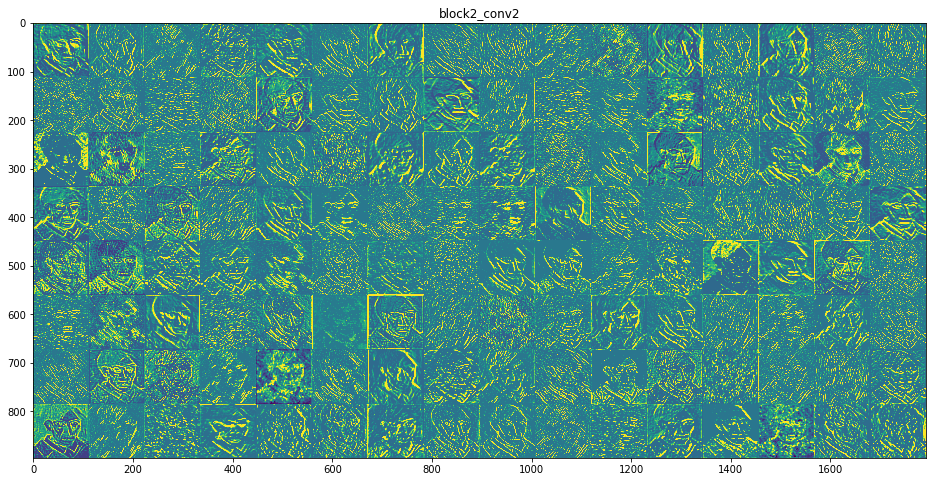

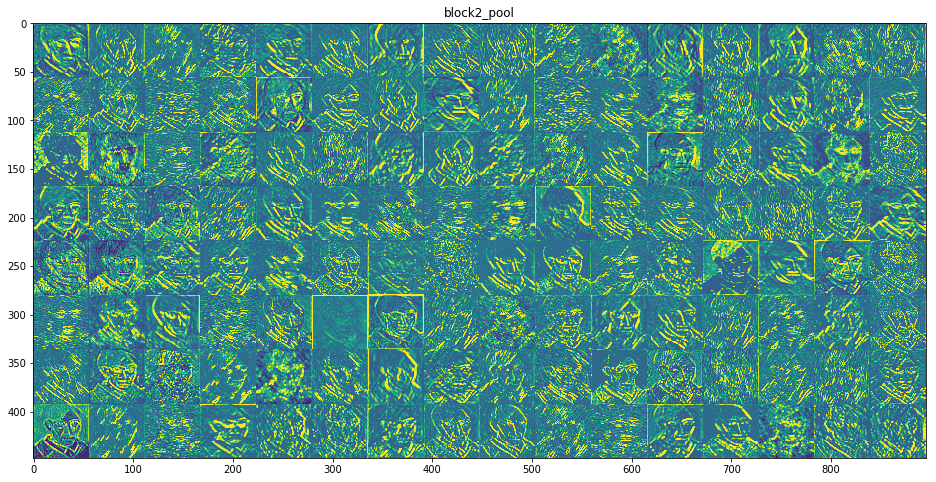

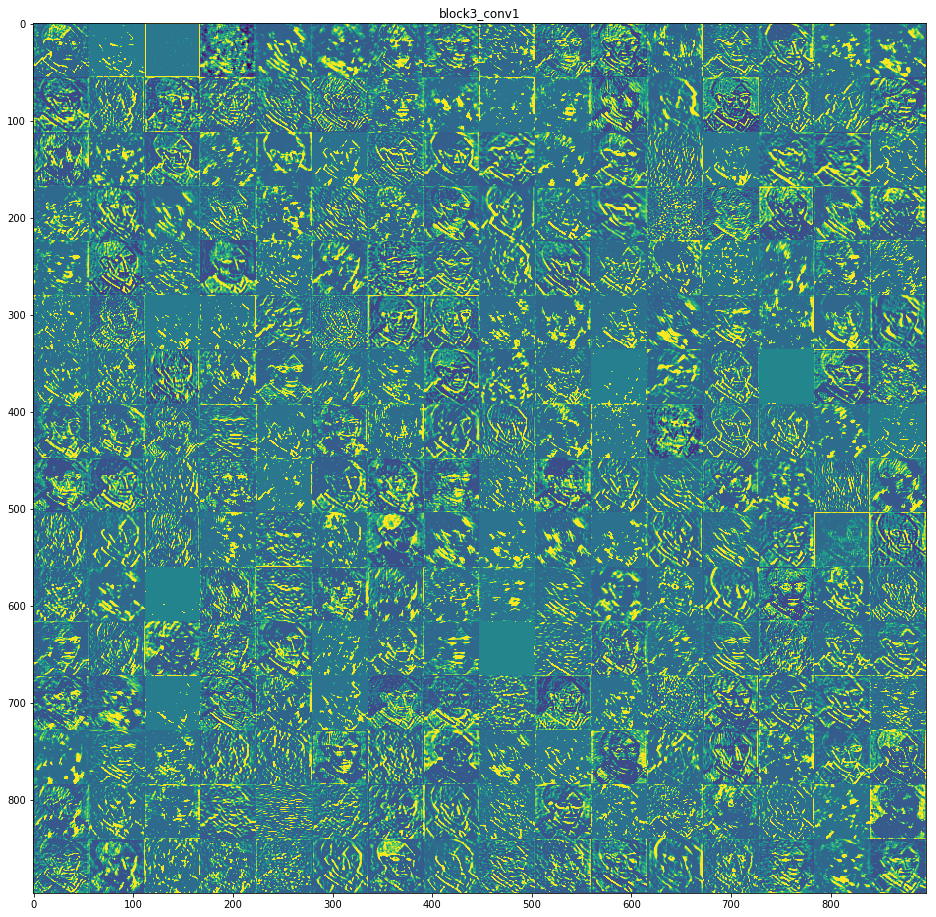

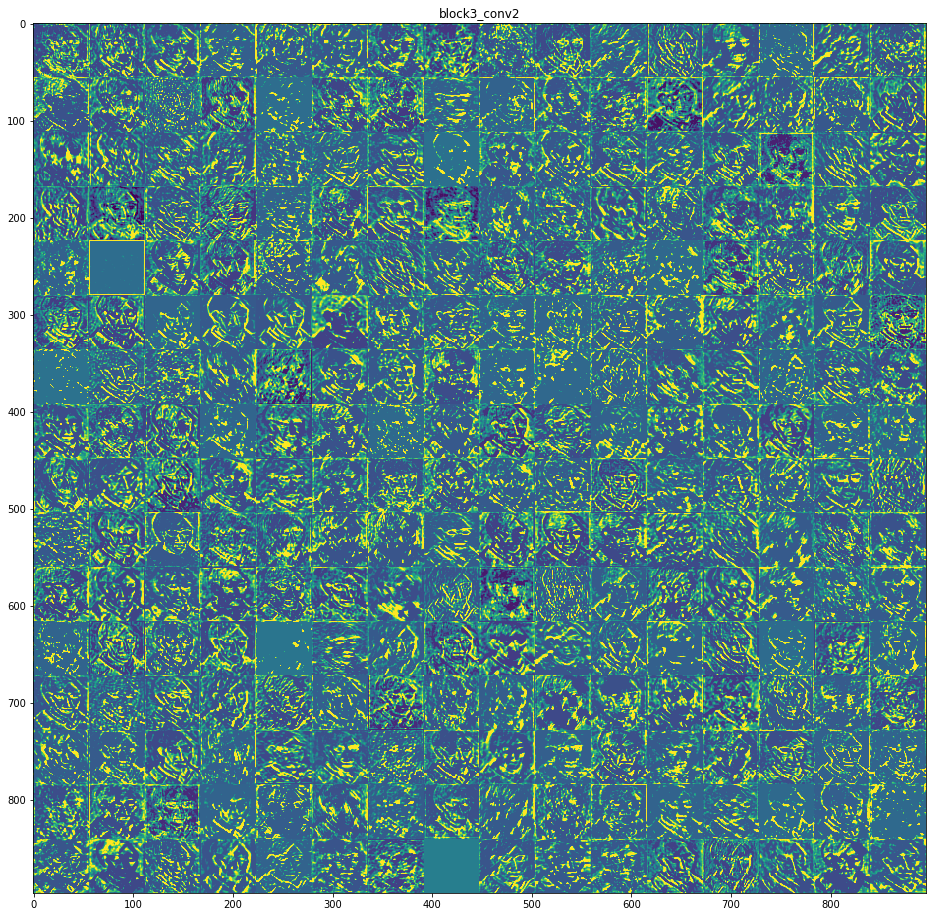

...

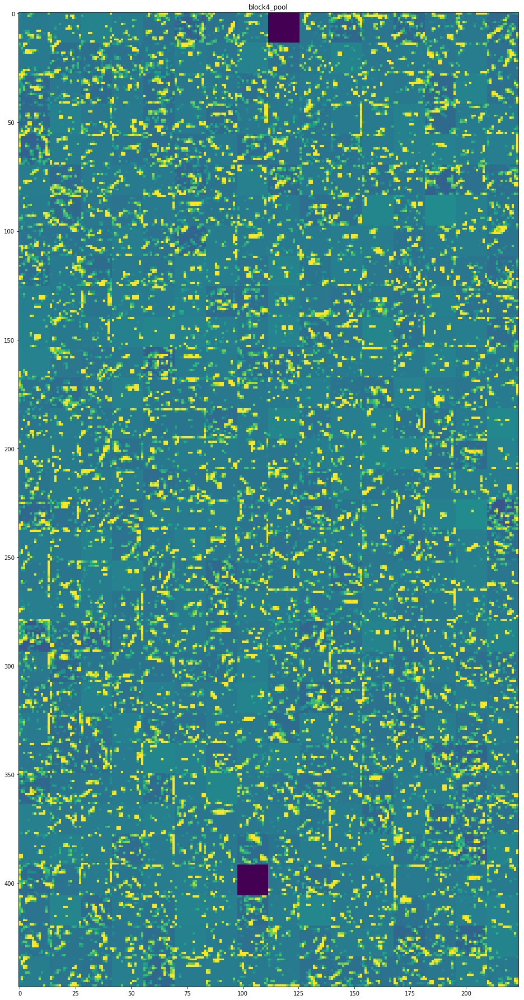

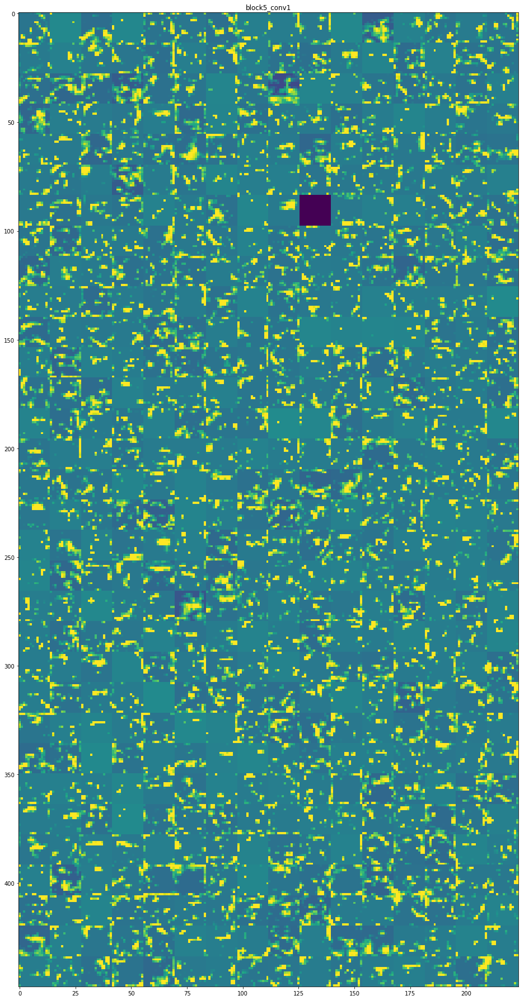

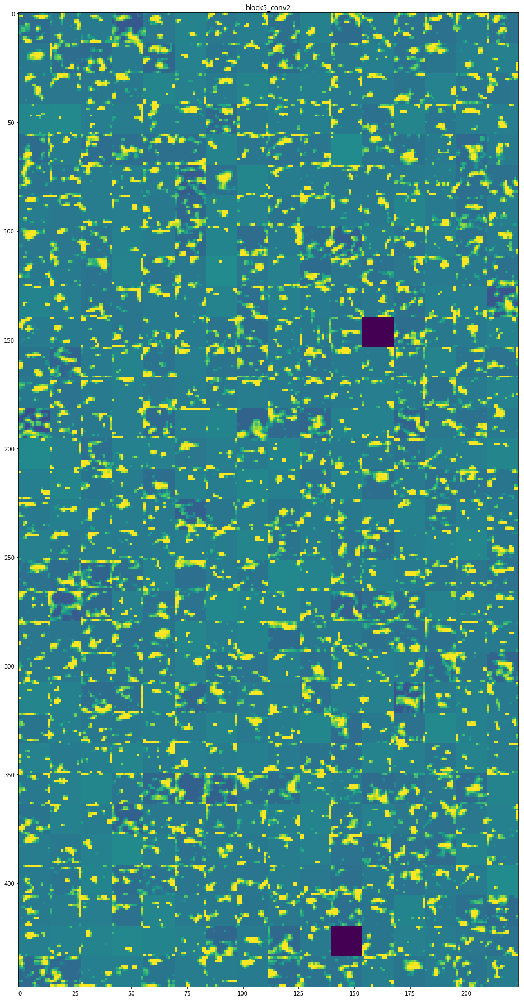

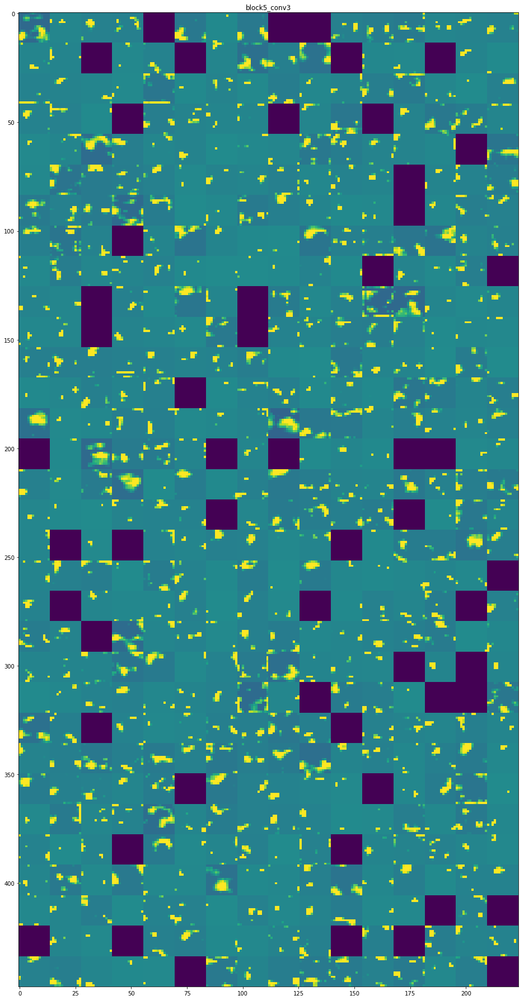

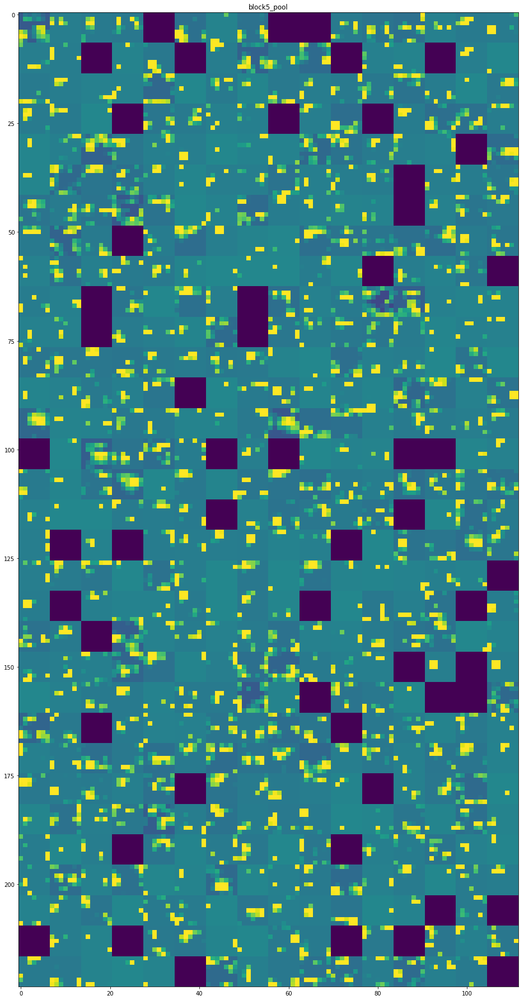

In [0]:
Visualise('picasso_selfportrait.jpg')

Before we proceed much further, we need to massage this input data to match what was done in Simonyan and Zisserman (2015) ( [Simonyan and Zisserman (2015)](https://arxiv.org/abs/1409.1556), the paper that introduces the VGG Network model that we're going to use shortly.

For this, we need to perform two transformations:


*  Subtract the mean RGB value (computed previously on the[ ImageNet training set](http://image-net.org/) and easily obtainable from Google searches) from each pixel.
*  Flip the ordering of the multi-dimensional array from RGB to BGR (the ordering used in the paper).

In [0]:
def preprocess_image(image):
  
  image=image.resize((height,width))
  array=np.asarray(image,dtype='float32')
  array=np.expand_dims(array,axis=0)
  array[:,:,:,0]-=103.939
  array[:,:,:,1]-=116.779
  array[:,:,:,2]-=123.68
  array=array[:,:,:,::-1]
  return array;

In [0]:
content_array = preprocess_image(content_image)
print(content_array.shape)

style_array = preprocess_image(style_image)
print(style_array.shape)


(1, 512, 512, 3)
(1, 512, 512, 3)


In [0]:
combination_image = backend.placeholder((1, height, width, 3))
input_tensor = backend.concatenate([content_array,
                                    style_array,
                                    combination_image], axis=0)



In [0]:
#Note that by setting include_top=False in the code below, we don't include any of the fully connected layers.
model = VGG16(input_tensor=input_tensor,weights='imagenet',
              include_top=False)


In [0]:
layers = dict([(layer.name, layer.output) for layer in model.layers])
layers

{'block1_conv1': <tf.Tensor 'block1_conv1_4/Relu:0' shape=(3, 512, 512, 64) dtype=float32>,
 'block1_conv2': <tf.Tensor 'block1_conv2_4/Relu:0' shape=(3, 512, 512, 64) dtype=float32>,
 'block1_pool': <tf.Tensor 'block1_pool_4/MaxPool:0' shape=(3, 256, 256, 64) dtype=float32>,
 'block2_conv1': <tf.Tensor 'block2_conv1_4/Relu:0' shape=(3, 256, 256, 128) dtype=float32>,
 'block2_conv2': <tf.Tensor 'block2_conv2_4/Relu:0' shape=(3, 256, 256, 128) dtype=float32>,
 'block2_pool': <tf.Tensor 'block2_pool_4/MaxPool:0' shape=(3, 128, 128, 128) dtype=float32>,
 'block3_conv1': <tf.Tensor 'block3_conv1_4/Relu:0' shape=(3, 128, 128, 256) dtype=float32>,
 'block3_conv2': <tf.Tensor 'block3_conv2_4/Relu:0' shape=(3, 128, 128, 256) dtype=float32>,
 'block3_conv3': <tf.Tensor 'block3_conv3_4/Relu:0' shape=(3, 128, 128, 256) dtype=float32>,
 'block3_pool': <tf.Tensor 'block3_pool_4/MaxPool:0' shape=(3, 64, 64, 256) dtype=float32>,
 'block4_conv1': <tf.Tensor 'block4_conv1_4/Relu:0' shape=(3, 64, 64, 51

In [0]:
content_weight = 0.025
style_weight = 5.0
total_variation_weight = 1.0

In [0]:
loss = backend.variable(0.)

**The content loss**

For the content loss, we follow Johnson et al. (2016) and draw the content feature from block2_conv2, because the original choice in Gatys et al. (2015) (block4_conv2) loses too much structural detail. And at least for faces, I find it more aesthetically pleasing to closely retain the structure of the original content image.

The content loss is the (scaled, squared) Euclidean distance between feature representations of the content and combination images.

In [0]:
def content_loss(content, combination):
    return backend.sum(backend.square(combination - content))

layer_features = layers['block2_conv2']
content_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]

loss+= (content_weight * content_loss(content_image_features,
                                      combination_features))

**The style loss**

For the style loss, we first define something called a Gram matrix. The terms of this matrix are proportional to the covariances of corresponding sets of features, and thus captures information about which features tend to activate together. By only capturing these aggregate statistics across the image, they are blind to the specific arrangement of objects inside the image. This is what allows them to capture information about style independent of content. ( [This](https://arxiv.org/abs/1606.01286)will refer you to a paper that attempts to explain the idea.)

The Gram matrix can be computed efficiently by reshaping the feature spaces suitably and taking an outer product.

In [0]:
def gram_matrix(x):
    features = backend.batch_flatten(backend.permute_dimensions(x, (2, 0, 1)))
    gram = backend.dot(features, backend.transpose(features))
    return gram

The style loss is then the (scaled, squared) Frobenius norm of the difference between the Gram matrices of the style and combination images.

Again, in the following code, I've chosen to go with the style features from layers defined in Johnson et al. (2016) rather than Gatys et al. (2015) because I find the end results more aesthetically pleasing. I encourage you to experiment with these choices to see varying results.

In [0]:
def style_loss(style, combination):
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = height * width
    return backend.sum(backend.square(S - C)) / (4. * (channels ** 2) * (size ** 2))

In [0]:
feature_layers = ['block1_conv2','block2_conv2',
                  'block3_conv3', 'block4_conv3',
                  'block5_conv3']

In [0]:
for layer_name in feature_layers:
    layer_features=layers[layer_name]
    style_features=layer_features[1,:,:,:]
    combination_features=layer_features[2,:,:,:]
    sl=style_loss(style_features,combination_features)
    loss+=(style_weight/len(feature_layers))*sl

**The total variation loss**
Now we're back on simpler ground.

If you were to solve the optimisation problem with only the two loss terms we've introduced so far (style and content), you'll find that the output is quite noisy. We thus add another term, called the total variation loss (a regularisation term) that encourages spatial smoothness.

You can experiment with reducing the [total_variation_weight](https://arxiv.org/abs/1412.0035) and play with the noise-level of the generated image.

In [0]:
def total_variation_loss(x):
    a = backend.square(x[:, :height-1, :width-1, :] - x[:, 1:, :width-1, :])
    b = backend.square(x[:, :height-1, :width-1, :] - x[:, :height-1, 1:, :])
    return backend.sum(backend.pow(a + b, 1.25))

loss += total_variation_weight * total_variation_loss(combination_image)

Define needed gradients and solve the optimisation problem

[The goal of this journey](https://harishnarayanan.org/writing/artistic-style-transfer/) was to setup an optimisation problem that aims to solve for a combination image that contains the content of the content image, while having the style of the style image. Now that we have our input images massaged and our loss function calculators in place, all we have left to do is define gradients of the total loss relative to the combination image, and use these gradients to iteratively improve upon our combination image to minimise the loss.

We start by defining the gradients.

In [0]:
grads = backend.gradients(loss, combination_image)

We then introduce an Evaluator class that computes loss and gradients in one pass while retrieving them via two separate functions, loss and grads. This is done because scipy.optimize requires separate functions for loss and gradients, but computing them separately would be inefficient.

In [0]:
outputs = [loss]
outputs += grads
f_outputs = backend.function([combination_image], outputs)

def eval_loss_and_grads(x):
    x = x.reshape((1, height, width, 3))
    outs = f_outputs([x])
    loss_value = outs[0]
    grad_values = outs[1].flatten().astype('float64')
    return loss_value, grad_values

class Evaluator(object):

    def __init__(self):
        self.loss_value = None
        self.grads_values = None

    def loss(self, x):
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

evaluator = Evaluator()

Now we're finally ready to solve our optimisation problem. This combination image begins its life as a random collection of (valid) pixels, and we use the [L-BFGS ](https://blog.slavv.com/picking-an-optimizer-for-style-transfer-86e7b8cba84b)algorithm (a quasi-Newton algorithm that's significantly quicker to converge than standard gradient descent) to iteratively improve upon it.

We stop after 10 iterations because the output looks good to me and the loss stops reducing significantly.

In [0]:
x = np.random.uniform(0, 255, (1, height, width, 3)) - 128.

iterations = 10

for i in range(iterations):
    print('Start of iteration', i)
    start_time = time.time()
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                     fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    end_time = time.time()
    print('Iteration %d completed in %ds' % (i, end_time - start_time))

Start of iteration 0
Current loss value: 133204060000.0
Iteration 0 completed in 7s
Start of iteration 1
Current loss value: 53803040000.0
Iteration 1 completed in 6s
Start of iteration 2
Current loss value: 36172440000.0
Iteration 2 completed in 6s
Start of iteration 3
Current loss value: 28640141000.0
Iteration 3 completed in 7s
Start of iteration 4
Current loss value: 25414795000.0
Iteration 4 completed in 7s
Start of iteration 5
Current loss value: 23730512000.0
Iteration 5 completed in 7s
Start of iteration 6
Current loss value: 22578741000.0
Iteration 6 completed in 7s
Start of iteration 7
Current loss value: 21844414000.0
Iteration 7 completed in 7s
Start of iteration 8
Current loss value: 21398157000.0
Iteration 8 completed in 7s
Start of iteration 9
Current loss value: 21072482000.0
Iteration 9 completed in 7s


(Note that we need to subject our output image to the inverse of the transformation we did to our input images before it makes sense.)

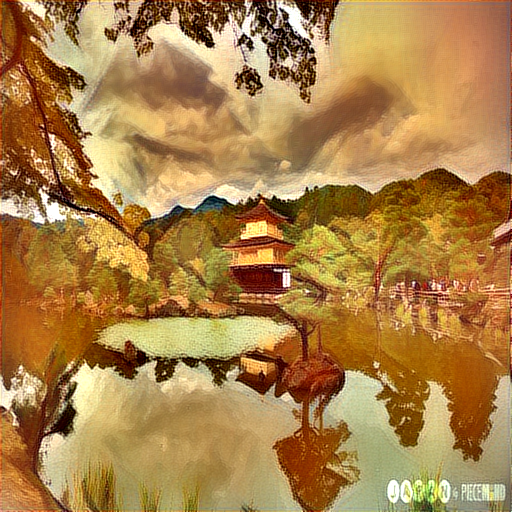

In [0]:

x = x.reshape((height, width, 3))
x = x[:, :, ::-1]
x[:, :, 0] += 103.939
x[:, :, 1] += 116.779
x[:, :, 2] += 123.68
x = np.clip(x, 0, 255).astype('uint8')

Image.fromarray(x)

Text(0.5, 1.0, 'style image')

<Figure size 432x288 with 0 Axes>

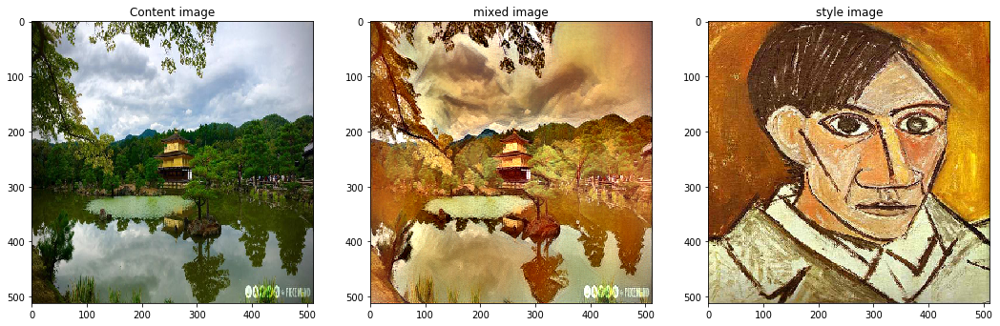

In [0]:
plt.figure()
fig = plt.figure(figsize=(18,18))
a=fig.add_subplot(131)
plt.imshow(content_image)
a.set_title('Content image')

a=fig.add_subplot(132)
plt.imshow(Image.fromarray(x))
a.set_title('mixed image')

a=fig.add_subplot(133)
plt.imshow(style_image)
a.set_title('style image')
